# Exploring the data deeper and feature selection

In [2]:
import pandas as pd
import numpy as np
import feather
import seaborn as sns
from matplotlib import pyplot as plt
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, chi2#, mutual_info_classif

import warnings
warnings.filterwarnings("ignore")

In [88]:
FILENAME = "feateng_data"
data = feather.read_dataframe(f"Datasets/{FILENAME}.feather")

## Geospatial Visualisation

### Basic plot

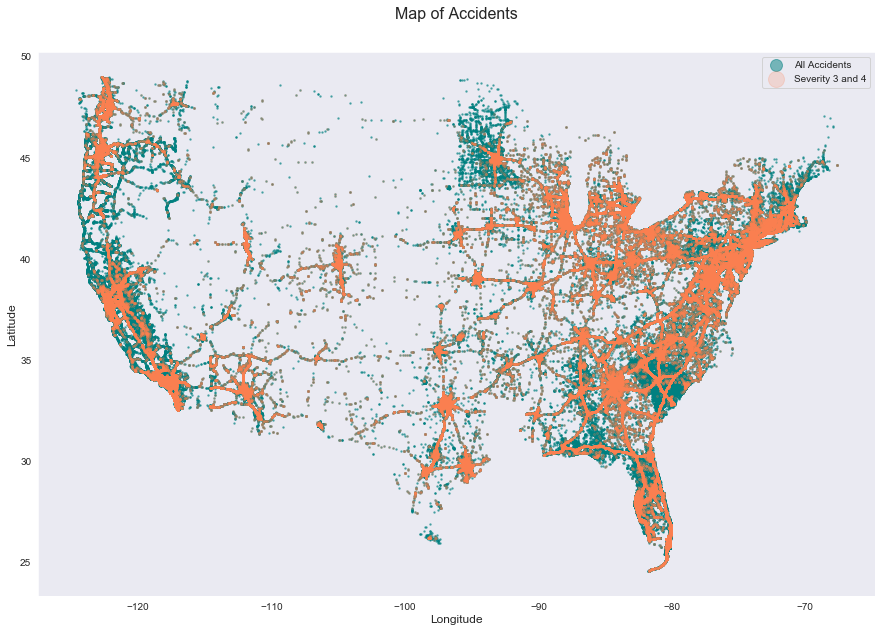

In [70]:
df_1 = data[data['Severity']==1]
sns.set_style('dark')
plt.figure(figsize=(15,10))

plt.plot( 'Start_Lng', 'Start_Lat', data=data, linestyle='', marker='o', markersize=1.5, color="teal", alpha=0.5, label='All Accidents')
plt.plot( 'Start_Lng', 'Start_Lat', data=df_1, linestyle='', marker='o', markersize=2, color="coral", alpha=0.2, label='Severity 3 and 4')
plt.legend(markerscale=8)
plt.xlabel('Longitude', size=12, labelpad=3)
plt.ylabel('Latitude', size=12, labelpad=3)
plt.title('Map of Accidents', size=16, y=1.05)
plt.show()

### Hexbin plot

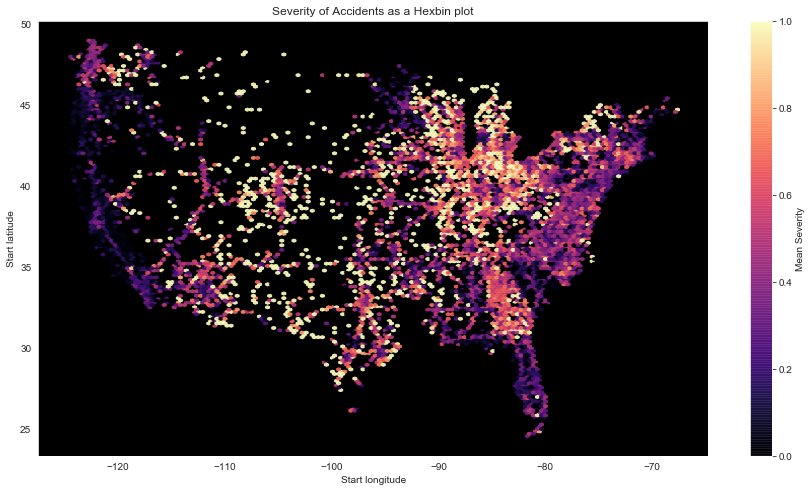

In [105]:
fig = data.plot.hexbin(x='Start_Lng', y='Start_Lat', C='Severity',
                       gridsize=200, cmap="magma", alpha=0.9,
                            sharex=False, figsize=(15,8))
fig.set_facecolor('black')
plt.title('Severity of Accidents as a Hexbin plot')
plt.xlabel('Start longitude')
plt.ylabel('Start latitude')
f = plt.gcf()
cax = f.get_axes()[1]
cax.set_ylabel('Mean Severity')

plt.show()

### Interactable map

In [66]:
from bokeh.plotting import figure, show, save, output_file
from bokeh.models import Legend, LegendItem
# tile providers are the underlying map 
from bokeh.tile_providers import get_provider, Vendors

# to display bokeh plots inside jupyter, we need to use output_notebook
from bokeh.io import reset_output, output_notebook
reset_output()
output_notebook()

Loading BokehJS ...

In [73]:
def lat2mercer(coords):
    """
    Function which converts latitude to its mercer coordinate representation
    """
    k = 6378137
    converted = list()
    for lat in coords:
        converted.append(np.log(np.tan((90 + lat) * np.pi/360.0)) * k)
    return converted

def lon2mercer(coords):
    """
    Function which converts longitude to its mercer coordinate representation
    """
    k = 6378137
    converted = list()
    for lon in coords:
        converted.append(lon * (k * np.pi/180.0))
    return converted

In [79]:
TILE = get_provider("CARTODBPOSITRON")

# Sample only 500,000
temp = data.sample(500000)
temp['startX'] = data['Start_Lng'].apply(lambda x: lon2mercer([x])[0])
temp['startY'] = data['Start_Lat'].apply(lambda x: lat2mercer([x])[0])

In [80]:
COORDS = ['Start_Lat', 'Start_Lng']
Bbox = temp[COORDS].describe().loc[['min','max']].values
yRange, xRange = sorted(i[0] for i in Bbox), sorted(i[1] for i in Bbox)

In [81]:
output_file(filename="Plots/interactive_map.html", title="Static HTML file")

pStart = figure(x_range=lon2mercer(xRange), y_range=lat2mercer(yRange),
       x_axis_type="mercator", y_axis_type="mercator", plot_width=1000)

pStart.add_tile(TILE)
pStart.title.text = "Accidents in US (Sample 500,000 instances)"

pStart.xaxis.axis_label = 'Longitude'
pStart.yaxis.axis_label = 'Lattitude'

# Severity = 0
c0 = pStart.circle(x='startX', y='startY', 
         size=5, fill_alpha=0.2, line_alpha=0, fill_color="teal",
         source=temp[['startX','startY','Severity']])

# Severity = 1
c1 = pStart.circle(x='startX', y='startY', 
         size=5, fill_alpha=0.2, line_alpha=0, fill_color="coral",
         source=temp[temp['Severity']==1][['startX','startY','Severity']])

legend = Legend(items=[
    ("All Accidents",   [c0]),
    ("High Severity Accidents", [c1])
], location=(10, 464))

pStart.add_layout(legend, 'right')
save(pStart)

'C:\\Users\\liyoa\\OneDrive\\Documents\\GitHub\\Accident_Severity\\Plots\\interactive_map.html'

In [83]:
show(pStart)

# Feature Analysis and Selection

### Numerical Attributes

In [5]:
num_cols = ['Severity', 
            'Temperature(K)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 
            'Wind_Speed(mph)', 'Precipitation(in)', 'Population_County', 'Drive_County', 
            'Transit_County', 'Walk_County', 'MedianHouseholdIncome_County'
           ]

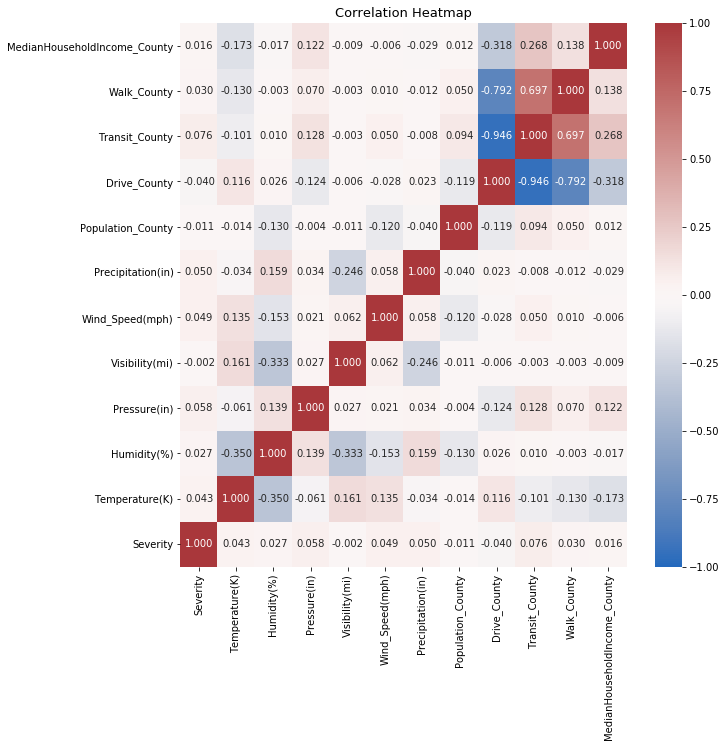

In [5]:
plt.figure(figsize=(10,10))

corr = data[num_cols].corr()

ax = sns.heatmap(corr,
 vmax=1, vmin=-1, cmap=sns.color_palette("vlag", as_cmap=True), annot=True, fmt='.3f');
ax.invert_yaxis()
plt.title("Correlation Heatmap", fontsize=13)

plt.show()

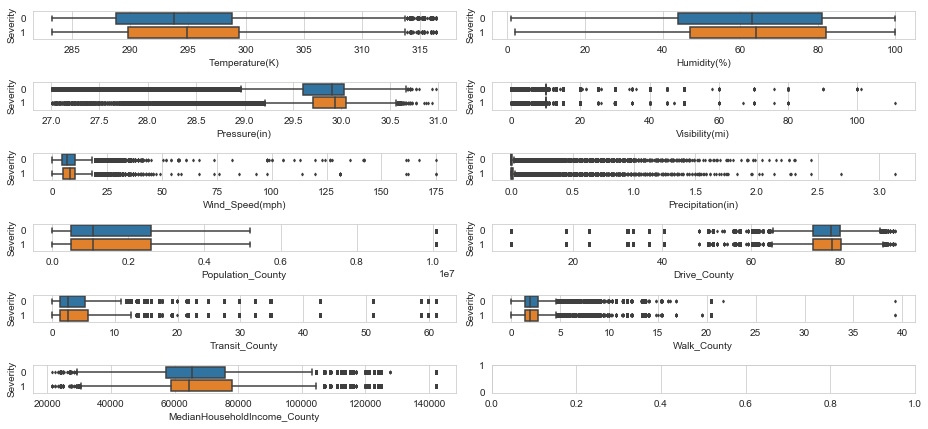

In [12]:
sns.set_style('whitegrid')
f, axes = plt.subplots(6,2, figsize=(13,6))  
y = 0

# modifying outlier markers
flierprops = dict(markersize=2, linestyle='none') 
for c in num_cols[1:]:
    i, j = divmod(y, 2)
    b=sns.boxplot(data=data, x=c, y="Severity", ax=axes[i, j], flierprops=flierprops, orient='h')
    b.set_xlabel(c)
    y = y+1

plt.tight_layout()
plt.show()

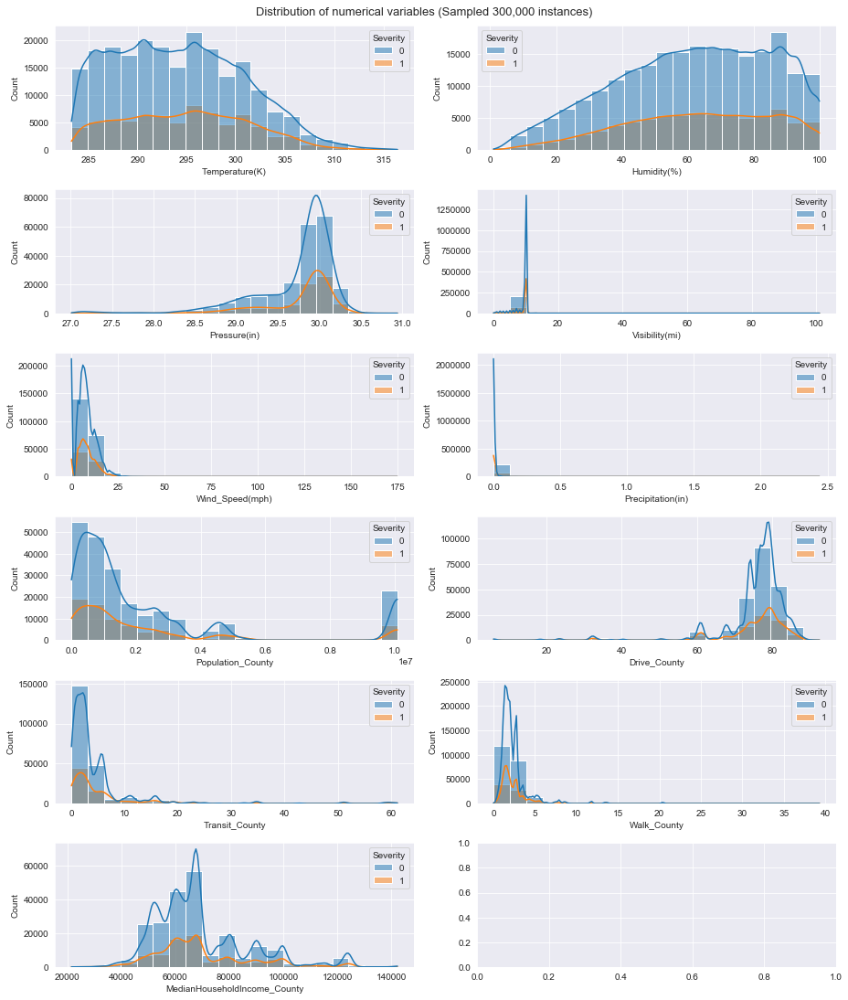

In [13]:
sns.set_style('darkgrid')
f, axes = plt.subplots(6,2, figsize=(13,15))  
y = 0

temp = data.sample(300000)
f.suptitle("Distribution of numerical variables (Sampled 300,000 instances)", y=1.01, fontsize=13)
for c in num_cols[1:]:
    i, j = divmod(y, 2)
    h=sns.histplot(data=temp, x=c, hue="Severity", bins=20, kde=True, ax=axes[i,j])
    h.set_xlabel(c)
    y = y+1

plt.tight_layout()
plt.show()

Since the distribution of the numerical variables are very similar for both low and high severity, and the correlation is also very low, this would mean that they will not really be useful in our model.

In [89]:
data.drop(num_cols[1:], axis=1, inplace=True)

## Categorical Variables

In [14]:
data.columns

Index(['Severity', 'Start_Time', 'Start_Lat', 'Start_Lng', 'Street', 'Side',
       'City', 'County_x', 'State_x', 'Zipcode', 'Timezone', 'Airport_Code',
       'Weather_Timestamp', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)',
       'Wind_Direction', 'Wind_Speed(mph)', 'Precipitation(in)',
       'Weather_Condition', 'Amenity', 'Bump', 'Crossing', 'Give_Way',
       'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop',
       'Traffic_Calming', 'Traffic_Signal', 'Sunrise_Sunset', 'Civil_Twilight',
       'Nautical_Twilight', 'Astronomical_Twilight', 'Population_County',
       'Drive_County', 'Transit_County', 'Walk_County',
       'MedianHouseholdIncome_County', 'Hour', 'Weekday', 'Month',
       'Temperature(K)', 'Ave', 'Rd', 'I'],
      dtype='object')

In [15]:
cat_cols = ['Side', 'Timezone', 'State_x', 'Weather_Condition', 
            'Amenity', 'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway', 
            'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal', 
            'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight',
            'Hour', 'Weekday', 'Month', 'Ave', 'Rd', 'I'
           ]

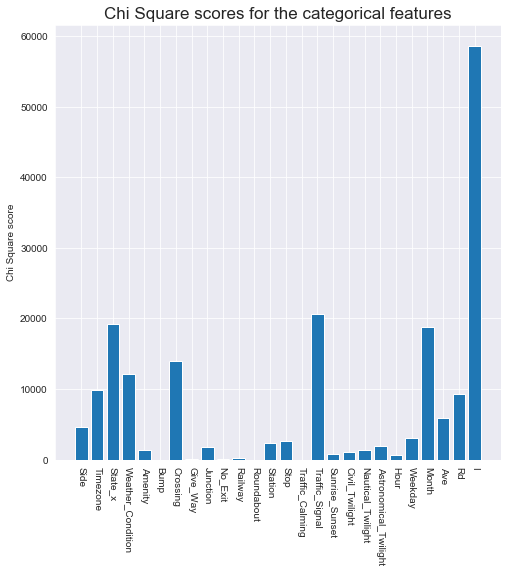

In [16]:
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder

# prepare input data
def prepare_inputs(X_train, X_test):
    oe = OrdinalEncoder()
    oe.fit(X_train)
    X_train_enc = oe.transform(X_train)
    X_test_enc = oe.transform(X_test)
    return X_train_enc, X_test_enc

# prepare target
def prepare_targets(y_train, y_test):
    le = LabelEncoder()
    le.fit(y_train)
    y_train_enc = le.transform(y_train)
    y_test_enc = le.transform(y_test)
    return y_train_enc, y_test_enc

# feature selection
def select_features(X_train, y_train, X_test):
    fs = SelectKBest(score_func=chi2, k='all')
    fs.fit(X_train, y_train)
    X_train_fs = fs.transform(X_train)
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs

X_train, X_test, y_train, y_test = train_test_split(data[cat_cols],
                                                    data['Severity'], test_size=0.33, random_state=30034)
# prepare input data
X_train_enc, X_test_enc = prepare_inputs(X_train, X_test)
# prepare output data
y_train_enc, y_test_enc = prepare_targets(y_train, y_test)
# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train_enc, y_train_enc, X_test_enc)

# for i in range(len(fs.scores_)):
#     print(f"{col_names[i]}: {fs.scores_[i]}")

sns.set_style("darkgrid")
plt.figure(figsize=(8,8))
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.xticks(range(len(cat_cols)), cat_cols, rotation=270)
plt.ylabel('Chi Square score')
plt.title("Chi Square scores for the categorical features", fontsize=17)
plt.show()

### Get final attributes
* categories (one hot encoded): Side, Timezone, Weekday, State_x, Weather_Condition, Month
* boolean: Crossing, Traffic_Signal, Ave, Rd, I

In [90]:
df_cat = data
cat = ['Side','Timezone','Weekday', 'State_x', 'Weather_Condition', 'Month']
df[cat] = df_cat[cat].astype('category')

df_cat = pd.get_dummies(df_cat, columns=cat, drop_first=True)
df_cat = df.select_dtypes(include=['uint8'])

In [91]:
data = pd.concat([df_cat, data[['Crossing', 'Traffic_Signal', 'Ave', 'Rd', 'I', 'Severity']]], axis=1)
data.head(3)

,Side_R,Timezone_US/Eastern,Timezone_US/Mountain,Timezone_US/Pacific,Weekday_1,Weekday_2,Weekday_3,Weekday_4,Weekday_5,Weekday_6,...,Month_9,Month_10,Month_11,Month_12,Crossing,Traffic_Signal,Ave,Rd,I,Severity
0,1,1,0,0,1,0,0,0,0,0,...,0,0,0,0,False,False,False,True,False,0
1,1,1,0,0,0,0,0,0,0,0,...,0,1,0,0,False,False,False,False,False,0
2,1,0,0,1,0,0,0,0,0,1,...,0,0,0,1,False,False,False,False,False,0


In [92]:
data.reset_index(inplace=True, drop=True)
data.to_feather("Datasets/final_data.feather")